<h1 style="text-align: center; color: brown;"> Global Sales Analysis of Superstore Dataset Using Python and Plotly Express </h1>

## Research Questions
**Question 1: How do sales change over time by region and market?** <br>
**Question 2: Which product categories and sub-categories generate the highest and lowest revenue, and how has this changed over time?** <br>
**Question 3: How does sales performance vary by sales segment (Consumer, Corporate, Home Office)?** <br>
**Question 4: Which cities or states are the top contributors to total sales and profit, and which ones are underperforming?** <br>
**Question 5: What is the correlation between discount rates and profit margins? or Do discounts help or hurt profit?** <br>
**Question 6: Which product categories and sub-categories are the most (or least) profitable?** <br>
**Question 7: What is the impact of shipping cost on overall profitability? Are there shipping modes or regions that consistently incur high costs?** <br>
**Question 8: What is the average Lead time (Ship Date - Order Date), and how does it vary by region, market, or ship mode?** <br>
**Question 9: Who are the top 10 customers by sales and profit? What purchasing behaviors do they exhibit?** <br>
**Question 10: Which products have the highest sales volume but low profit margins? or Which products sell well but earn little profit?**

### Importing Essential Libraries

In [1]:
# Importing pandas for data manipulation and analysis
import pandas as pd
# Importing Plotly Express for quick and easy data visualizations
import plotly.express as px
# Importing graph_objs module from Plotly for more customized and advanced plots
from plotly import graph_objs as go
# Importing Plotly I/O module to configure global plotting settings
import plotly.io as pio
# Setting the default Plotly theme to 'plotly_white' for a clean visual style
pio.templates.default = "plotly_white"
# Importing Plotly's color module for accessing color palettes
import plotly.colors as pc
# Importing predefined qualitative color scales from Plotly for category-based visuals
from plotly.colors import qualitative

### Data Loading and Preliminary Exploration

In [2]:
# Reading the 'Orders' sheet from the Superstore Sales Data Excel file into a pandas DataFrame
superstore = pd.read_excel("Superstore Global Sales.xlsx", sheet_name="Orders")
# Displaying a random sample of 5 rows to get a quick look at the dataset
superstore.sample(5)

,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,City,State,...,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit,Shipping Cost,Order Priority
49900,19636,ES-2022-4717022,2022-08-16,2022-08-21,Standard Class,JL-15850,John Lucas,Consumer,Wolfsburg,Lower Saxony,...,OFF-LA-10000767,Office Supplies,Labels,"Hon Legal Exhibit Labels, Laser Printer Compat...",10.8600,1,0.00,1.9500,0.380,Medium
34168,36015,CA-2022-109736,2022-10-10,2022-10-11,First Class,DJ-13420,Denny Joy,Corporate,San Francisco,California,...,OFF-PA-10004101,Office Supplies,Paper,Xerox 1894,45.3600,7,0.00,21.7728,3.860,Medium
14294,37697,CA-2024-151981,2024-08-07,2024-08-13,Standard Class,GM-14455,Gary Mitchum,Home Office,Concord,New Hampshire,...,OFF-AR-10000380,Office Supplies,Art,"Hunt PowerHouse Electric Pencil Sharpener, Blue",227.8800,6,0.00,68.3640,21.100,Medium
18134,8763,US-2023-128965,2023-10-17,2023-10-20,First Class,SG-20080,Sandra Glassco,Consumer,Cuajimalpa,Distrito Federal,...,FUR-TA-10000310,Furniture,Tables,"Barricks Training Table, Rectangular",168.4640,1,0.20,-40.0160,14.767,Medium
29492,23877,IN-2022-58859,2022-10-30,2022-11-04,Standard Class,TS-21085,Thais Sissman,Consumer,Rach Gia,Kiên Giang,...,TEC-AC-10002883,Technology,Accessories,"Logitech Keyboard, Erganomic",74.4756,2,0.47,-8.4444,5.730,Medium


In [3]:
# Checking the number of rows and columns in the dataset (rows, columns)
superstore.shape

(51290, 24)

In [4]:
# Displaying the list of column names in the DataFrame
superstore.columns

Index(['Row ID', 'Order ID', 'Order Date', 'Ship Date', 'Ship Mode',
       'Customer ID', 'Customer Name', 'Segment', 'City', 'State', 'Country',
       'Postal Code', 'Market', 'Region', 'Product ID', 'Category',
       'Sub-Category', 'Product Name', 'Sales', 'Quantity', 'Discount',
       'Profit', 'Shipping Cost', 'Order Priority'],
      dtype='object')

In [5]:
# Displaying a concise summary of the DataFrame, including column data types, non-null counts, and memory usage
superstore.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51290 entries, 0 to 51289
Data columns (total 24 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   Row ID          51290 non-null  int64         
 1   Order ID        51290 non-null  object        
 2   Order Date      51290 non-null  datetime64[ns]
 3   Ship Date       51290 non-null  datetime64[ns]
 4   Ship Mode       51290 non-null  object        
 5   Customer ID     51290 non-null  object        
 6   Customer Name   51290 non-null  object        
 7   Segment         51290 non-null  object        
 8   City            51290 non-null  object        
 9   State           51290 non-null  object        
 10  Country         51290 non-null  object        
 11  Postal Code     9994 non-null   float64       
 12  Market          51290 non-null  object        
 13  Region          51290 non-null  object        
 14  Product ID      51290 non-null  object        
 15  Ca

In [6]:
# Calculating the number of unique values for each column in the DataFrame
superstore.nunique()

Row ID            51290
Order ID          25035
Order Date         1429
Ship Date          1463
Ship Mode             4
Customer ID        1590
Customer Name       795
Segment               3
City               3636
State              1094
Country             147
Postal Code         631
Market                7
Region               13
Product ID        10292
Category              3
Sub-Category         17
Product Name       3788
Sales             27200
Quantity             14
Discount             29
Profit            28234
Shipping Cost     17095
Order Priority        4
dtype: int64

In [7]:
# Generating descriptive statistics for all columns in the DataFrame, including numerical and categorical data
superstore.describe(include="all")

,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,City,State,...,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit,Shipping Cost,Order Priority
count,51290.00000,51290,51290,51290,51290,51290,51290,51290,51290,51290,...,51290,51290,51290,51290,51290.000000,51290.000000,51290.000000,51290.000000,51290.000000,51290
unique,NaN,25035,NaN,NaN,4,1590,795,3,3636,1094,...,10292,3,17,3788,NaN,NaN,NaN,NaN,NaN,4
top,NaN,CA-2024-100111,NaN,NaN,Standard Class,PO-18850,Muhammed Yedwab,Consumer,New York City,California,...,OFF-AR-10003651,Office Supplies,Binders,Staples,NaN,NaN,NaN,NaN,NaN,Medium
freq,NaN,14,NaN,NaN,30775,97,108,26518,915,2001,...,35,31273,6152,227,NaN,NaN,NaN,NaN,NaN,29433
mean,25645.50000,NaN,2023-05-12 21:29:27.502437120,2023-05-17 09:07:09.978553344,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,246.490581,3.476545,0.142908,28.610982,26.375818,NaN
min,1.00000,NaN,2021-01-01 00:00:00,2021-01-03 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0.444000,1.000000,0.000000,-6599.978000,0.002000,NaN
25%,12823.25000,NaN,2022-06-19 00:00:00,2022-06-24 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,30.758625,2.000000,0.000000,0.000000,2.610000,NaN
50%,25645.50000,NaN,2023-07-09 00:00:00,2023-07-14 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,85.053000,3.000000,0.000000,9.240000,7.790000,NaN
75%,38467.75000,NaN,2024-05-22 00:00:00,2024-05-27 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,251.053200,5.000000,0.200000,36.810000,24.450000,NaN
max,51290.00000,NaN,2024-12-31 00:00:00,2025-01-07 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,22638.480000,14.000000,0.850000,8399.976000,933.570000,NaN


### Data Cleaning and Transformation

In [8]:
# Checking for missing (null) values in each column and displaying the count of null values per column
superstore.isnull().sum()

Row ID                0
Order ID              0
Order Date            0
Ship Date             0
Ship Mode             0
Customer ID           0
Customer Name         0
Segment               0
City                  0
State                 0
Country               0
Postal Code       41296
Market                0
Region                0
Product ID            0
Category              0
Sub-Category          0
Product Name          0
Sales                 0
Quantity              0
Discount              0
Profit                0
Shipping Cost         0
Order Priority        0
dtype: int64

#### The 'Postal Code' column contains over 41,000 missing values and is not relevant to the analysis. Therefore, it will be removed from the dataset.

In [9]:
# Dropping the 'Postal Code' column from the DataFrame as it has a high number of missing values and is irrelevant to the analysis
superstore.drop("Postal Code", axis=1, inplace=True)

In [10]:
# Displaying a random sample of 5 rows from the DataFrame after removing the 'Postal Code' column to verify changes
superstore.sample(5)

,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,City,State,...,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit,Shipping Cost,Order Priority
28974,24313,IN-2024-24853,2024-12-05,2024-12-11,Standard Class,MM-18055,Michelle Moray,Consumer,Gold Coast,Queensland,...,TEC-MA-10002242,Technology,Machines,"StarTech Calculator, Durable",108.216,3,0.1,-12.024,5.97,Medium
11617,26779,IN-2021-50641,2021-12-23,2021-12-30,Standard Class,NF-18385,Natalie Fritzler,Consumer,Shenyang,Liaoning,...,TEC-PH-10003491,Technology,Phones,"Samsung Office Telephone, Full Size",199.530,3,0.0,15.930,27.68,Low
14664,15313,ES-2021-4816650,2021-10-21,2021-10-27,Standard Class,YS-21880,Yana Sorensen,Corporate,Helsinki,Uusimaa,...,FUR-FU-10000225,Furniture,Furnishings,"Rubbermaid Photo Frame, Durable",292.680,6,0.0,14.580,20.33,Medium
33642,48906,NI-2024-4860,2024-06-10,2024-06-16,Standard Class,JD-6015,Joy Daniels,Consumer,Lagos,Lagos,...,FUR-HON-10002424,Furniture,Chairs,"Hon Steel Folding Chair, Red",48.852,2,0.7,-37.488,4.04,Medium
44125,31822,CA-2022-158792,2022-12-26,2023-01-02,Standard Class,BD-11605,Brian Dahlen,Consumer,Lawrence,Massachusetts,...,OFF-FA-10002815,Office Supplies,Fasteners,Staples,22.200,5,0.0,10.434,1.39,Low


In [11]:
# Checking for any remaining missing (null) values in the DataFrame after data cleaning
superstore.isnull().sum()

Row ID            0
Order ID          0
Order Date        0
Ship Date         0
Ship Mode         0
Customer ID       0
Customer Name     0
Segment           0
City              0
State             0
Country           0
Market            0
Region            0
Product ID        0
Category          0
Sub-Category      0
Product Name      0
Sales             0
Quantity          0
Discount          0
Profit            0
Shipping Cost     0
Order Priority    0
dtype: int64

In [12]:
# Removing duplicate rows from the DataFrame to ensure data integrity
superstore.drop_duplicates()

,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,City,State,...,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit,Shipping Cost,Order Priority
0,32298,CA-2022-124891,2022-07-31,2022-07-31,Same Day,RH-19495,Rick Hansen,Consumer,New York City,New York,...,TEC-AC-10003033,Technology,Accessories,Plantronics CS510 - Over-the-Head monaural Wir...,2309.650,7,0.0,762.1845,933.570,Critical
1,26341,IN-2023-77878,2023-02-05,2023-02-07,Second Class,JR-16210,Justin Ritter,Corporate,Wollongong,New South Wales,...,FUR-CH-10003950,Furniture,Chairs,"Novimex Executive Leather Armchair, Black",3709.395,9,0.1,-288.7650,923.630,Critical
2,25330,IN-2023-71249,2023-10-17,2023-10-18,First Class,CR-12730,Craig Reiter,Consumer,Brisbane,Queensland,...,TEC-PH-10004664,Technology,Phones,"Nokia Smart Phone, with Caller ID",5175.171,9,0.1,919.9710,915.490,Medium
3,13524,ES-2023-1579342,2023-01-28,2023-01-30,First Class,KM-16375,Katherine Murray,Home Office,Berlin,Berlin,...,TEC-PH-10004583,Technology,Phones,"Motorola Smart Phone, Cordless",2892.510,5,0.1,-96.5400,910.160,Medium
4,47221,SG-2023-4320,2023-11-05,2023-11-06,Same Day,RH-9495,Rick Hansen,Consumer,Dakar,Dakar,...,TEC-SHA-10000501,Technology,Copiers,"Sharp Wireless Fax, High-Speed",2832.960,8,0.0,311.5200,903.040,Critical
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51285,29002,IN-2024-62366,2024-06-19,2024-06-19,Same Day,KE-16420,Katrina Edelman,Corporate,Kure,Hiroshima,...,OFF-FA-10000746,Office Supplies,Fasteners,"Advantus Thumb Tacks, 12 Pack",65.100,5,0.0,4.5000,0.010,Medium
51286,35398,US-2024-102288,2024-06-20,2024-06-24,Standard Class,ZC-21910,Zuschuss Carroll,Consumer,Houston,Texas,...,OFF-AP-10002906,Office Supplies,Appliances,Hoover Replacement Belt for Commercial Guardsm...,0.444,1,0.8,-1.1100,0.010,Medium
51287,40470,US-2023-155768,2023-12-02,2023-12-02,Same Day,LB-16795,Laurel Beltran,Home Office,Oxnard,California,...,OFF-EN-10001219,Office Supplies,Envelopes,"#10- 4 1/8"" x 9 1/2"" Security-Tint Envelopes",22.920,3,0.0,11.2308,0.010,High
51288,9596,MX-2022-140767,2022-02-18,2022-02-22,Standard Class,RB-19795,Ross Baird,Home Office,Valinhos,São Paulo,...,OFF-BI-10000806,Office Supplies,Binders,"Acco Index Tab, Economy",13.440,2,0.0,2.4000,0.003,Medium


### Data Analysis and Addressing Business Questions

In [13]:
# Calculating the total sales from the 'Sales' column and rounding the result to two decimal places
superstore["Sales"].sum().round(2)

12642501.91

In [14]:
# Calculating the total profit from the 'Profit' column and rounding the result to two decimal places
superstore["Profit"].sum().round(2)

1467457.29

In [15]:
# Calculating the total quantity sold by summing the values in the 'Quantity' column
superstore["Quantity"].sum()

178312

### Question 1: How do sales change over time by region and market?

In [16]:
# Generating time-based columns for year, quarter, and month from the 'Order Date' column
superstore["Year"] = superstore['Order Date'].dt.year
superstore['Year-Quarter'] = superstore['Order Date'].dt.to_period('Q').astype(str)
superstore["Year-Month"] = superstore["Order Date"].dt.to_period("M").astype(str)

In [17]:
# Displaying a random sample of 2 rows to verify the newly created time-based columns
superstore.sample(2)

,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,City,State,...,Product Name,Sales,Quantity,Discount,Profit,Shipping Cost,Order Priority,Year,Year-Quarter,Year-Month
10737,34453,CA-2022-139584,2022-08-24,2022-08-28,Standard Class,EM-13810,Eleni McCrary,Corporate,New York City,New York,...,Chromcraft Rectangular Conference Tables,284.364,2,0.4,-75.8304,30.26,High,2022,2022Q3,2022-08
9544,11160,ES-2023-4276357,2023-11-27,2023-11-29,First Class,AA-10315,Alex Avila,Consumer,Manchester,England,...,"Boston Canvas, Fluorescent",164.700,3,0.0,29.6100,34.69,High,2023,2023Q4,2023-11


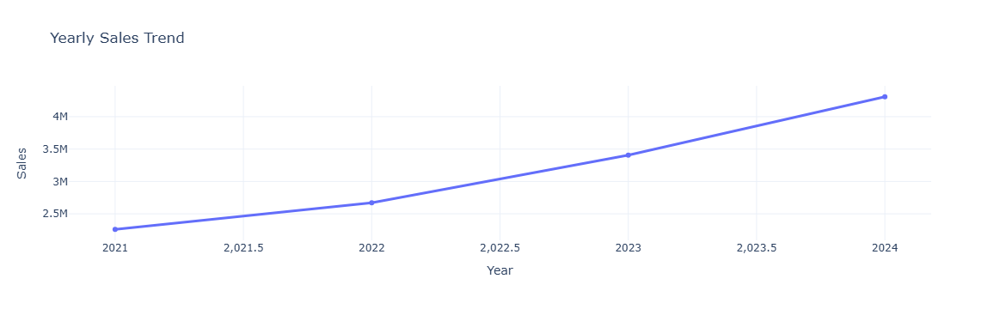

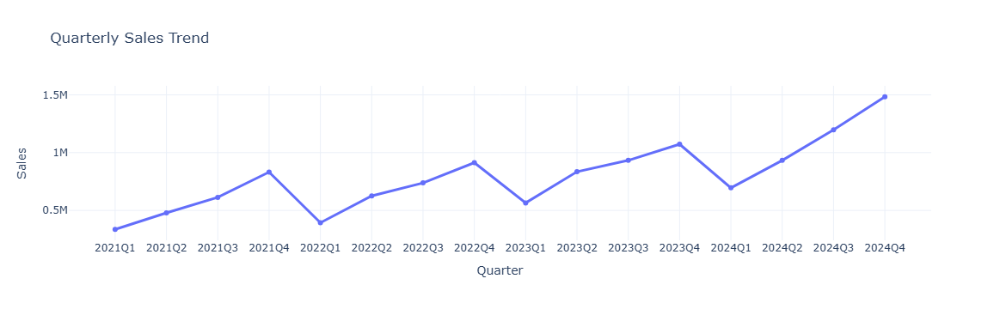

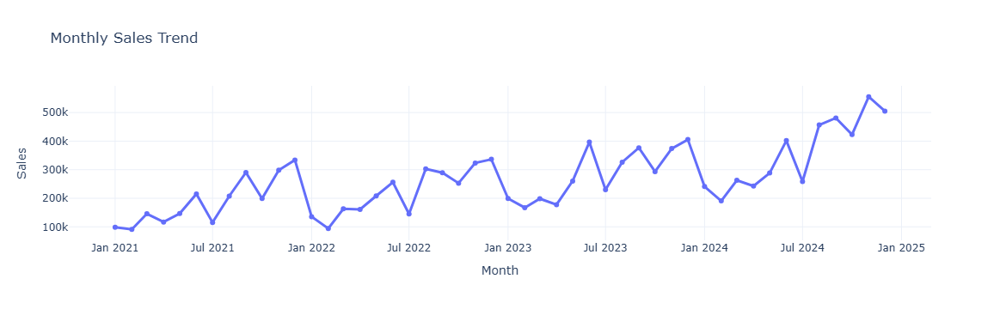

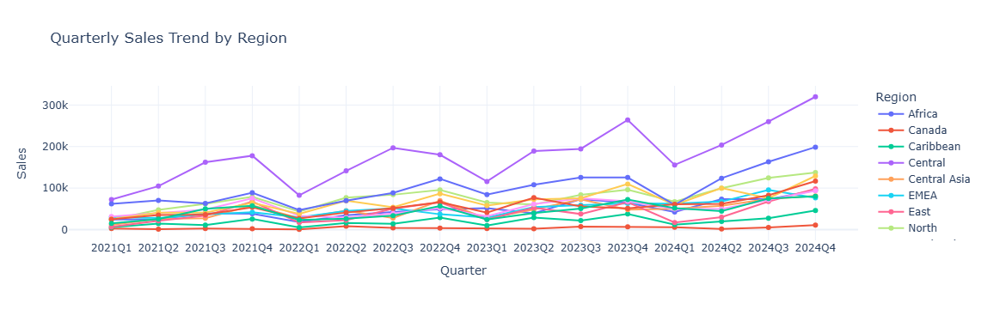

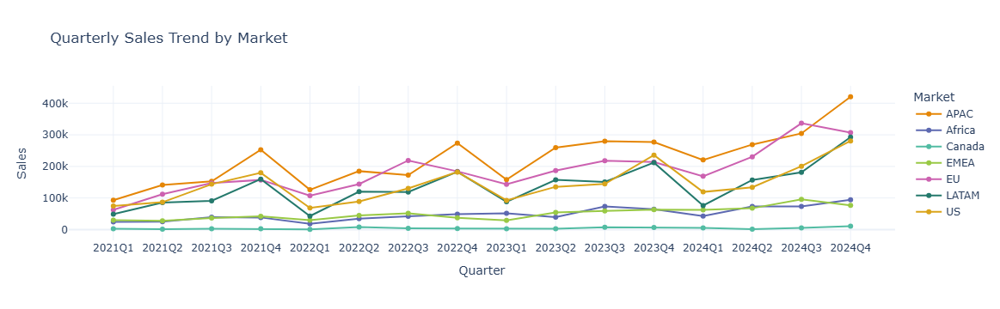

In [18]:
# 1. Yearly Sales Trend
yearly_sales = superstore.groupby("Year")["Sales"].sum().reset_index()
fig_yearsales = go.Figure()
fig_yearsales.add_trace(go.Scatter(x=yearly_sales["Year"],y=yearly_sales["Sales"], mode="lines+markers", name="Total Sales", line=dict(color=pc.qualitative.Plotly[0], width=3), marker=dict(size=6)))
fig_yearsales.update_layout(title="Yearly Sales Trend", xaxis_title="Year", yaxis_title="Sales", hovermode="x")

# 2. Quarterly Sales Trend
quarterly_sales = superstore.groupby("Year-Quarter")["Sales"].sum().reset_index()
fig_quartersales = go.Figure()
fig_quartersales.add_trace(go.Scatter(x=quarterly_sales["Year-Quarter"], y=quarterly_sales["Sales"], mode="lines+markers", name="Total Sales", line=dict(color=pc.qualitative.Plotly[0], width=3), marker=dict(size=6)))
fig_quartersales.update_layout(width=1250,title="Quarterly Sales Trend", xaxis_title="Quarter", yaxis_title="Sales", hovermode="x")

# 3. Monthly Sales Trend
monthly_sales = superstore.groupby("Year-Month")["Sales"].sum().reset_index()
fig_monthsales = go.Figure()
fig_monthsales.add_trace(go.Scatter(x=monthly_sales["Year-Month"], y=monthly_sales["Sales"], mode='lines+markers', name='Total Sales', line=dict(color=pc.qualitative.Plotly[0],width=3), marker=dict(size=6)))
fig_monthsales.update_layout(width=1250,title="Monthly Sales Trend", xaxis_title="Month", yaxis_title="Sales", hovermode='x')


# 4. Quarterly Sales Trend by Region
region_monthly_sales = superstore.groupby(["Year-Quarter", "Region"])["Sales"].sum().reset_index()
# Line chart
fig_regionsales = px.line(region_monthly_sales, x="Year-Quarter", y="Sales", color="Region", title="Quarterly Sales Trend by Region", markers=True, color_discrete_sequence=qualitative.Plotly)
fig_regionsales.update_traces(mode='markers+lines')
fig_regionsales.update_layout(xaxis_title="Quarter", yaxis_title="Sales", legend_title="Region")


# 5. Quarterly Sales Trend by Market
market_monthly_sales = superstore.groupby(["Year-Quarter", "Market"])["Sales"].sum().reset_index()
# Line chart
fig_marketsales = px.line(market_monthly_sales, x="Year-Quarter", y="Sales", color="Market", title="Quarterly Sales Trend by Market", markers=True, color_discrete_sequence=qualitative.Vivid)
fig_marketsales.update_traces(mode='markers+lines')
fig_marketsales.update_layout(xaxis_title="Quarter", yaxis_title="Sales", legend_title="Market")

# Show the figures
fig_yearsales.show()
fig_quartersales.show()
fig_monthsales.show()
fig_regionsales.show()
fig_marketsales.show()

### Question 2: Which product categories and sub-categories generate the highest and lowest revenue, and how has this changed over time?

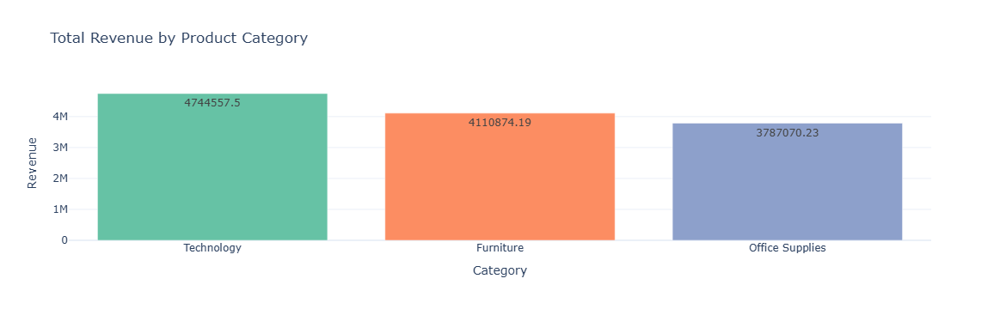

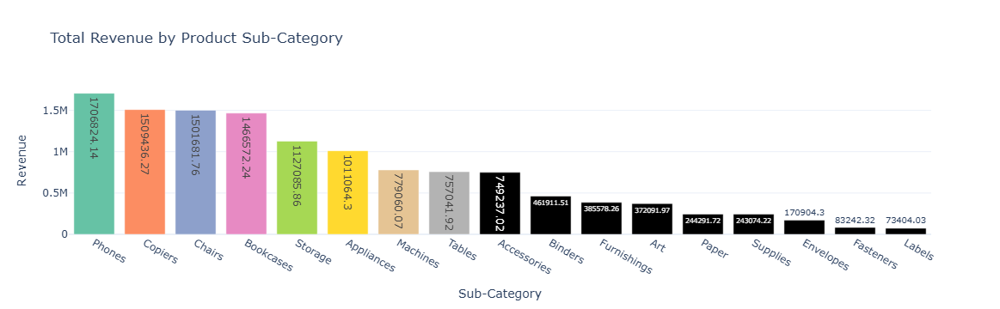

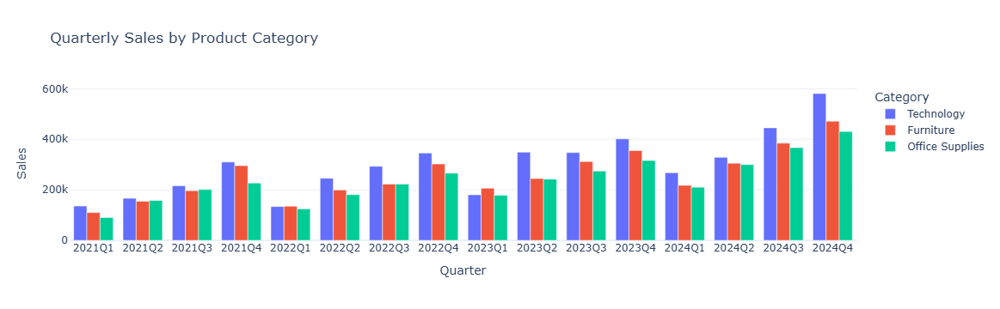

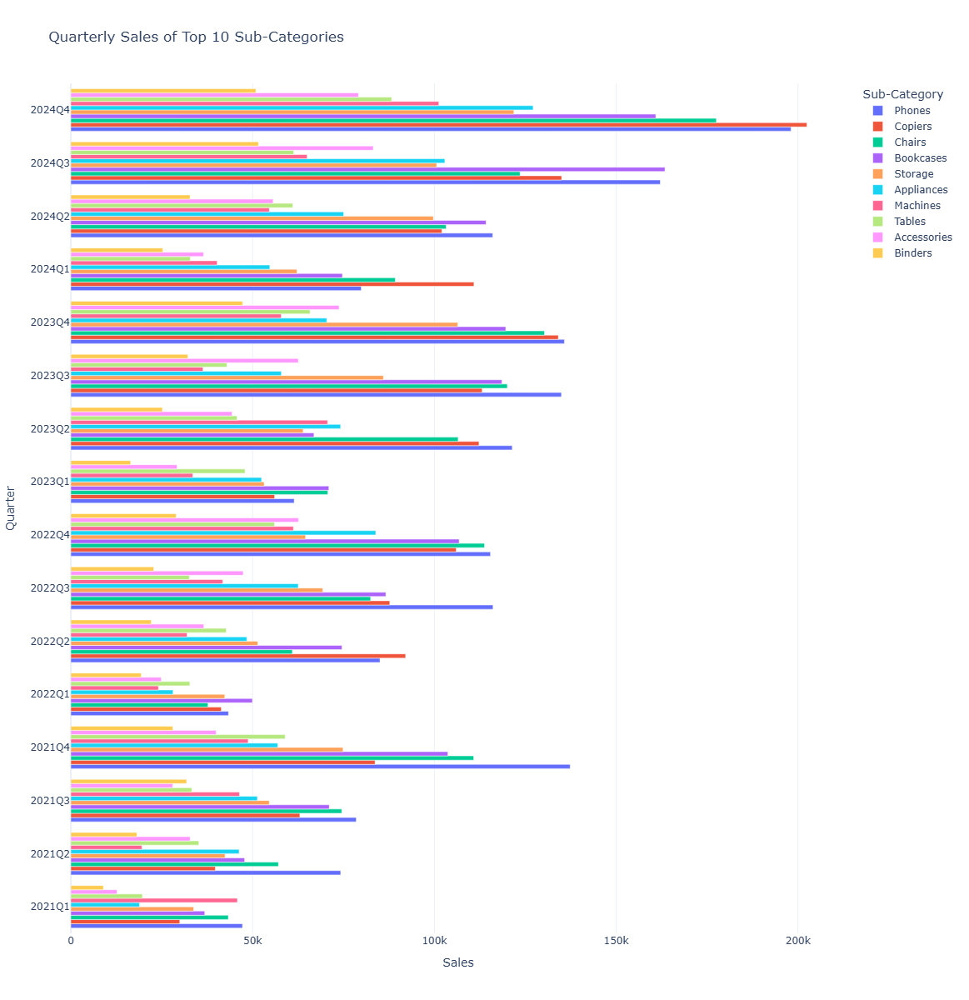

In [19]:
# 1. Total Revenue by Category
category_sales = superstore.groupby('Category')['Sales'].sum().sort_values(ascending=False).reset_index()
color = qualitative.Set2
fig_category = go.Figure(go.Bar(x=category_sales['Category'], y=category_sales['Sales'], marker=dict(color=color[:len(category_sales)]), text=category_sales['Sales'].round(2), textposition="auto"))
fig_category.update_layout(title="Total Revenue by Product Category", xaxis_title="Category", yaxis_title="Revenue")

# 2. Total Revenue by Sub-Category
subcategory_sales = superstore.groupby('Sub-Category')['Sales'].sum().sort_values(ascending=False).reset_index()
color = qualitative.Set2
fig_subcategory = go.Figure(go.Bar(x=subcategory_sales['Sub-Category'], y=subcategory_sales['Sales'], marker=dict(color=color[:len(subcategory_sales)]), text=subcategory_sales['Sales'].round(2), textposition="auto"))
fig_subcategory.update_layout(title="Total Revenue by Product Sub-Category", xaxis_title="Sub-Category", yaxis_title="Revenue")

# 3. Revenue Trend Over Time by Category
category_yearquarter_sales = superstore.groupby(['Year-Quarter', 'Category'])['Sales'].sum().reset_index()
categories = category_sales["Category"].unique()
yearquarter_sales = sorted(category_yearquarter_sales["Year-Quarter"].unique())
fig_categoryquartersales = go.Figure()
colors = qualitative.Plotly
for i, category in enumerate(categories):
    data = category_yearquarter_sales[category_yearquarter_sales['Category'] == category]
    fig_categoryquartersales.add_trace(go.Bar(x=data['Year-Quarter'], y=data['Sales'], name=category, marker_color=colors[i % len(colors)]))
fig_categoryquartersales.update_layout(barmode="group",title='Quarterly Sales by Product Category', xaxis=dict(title="Quarter"), yaxis=dict(title="Sales"), legend_title_text="Category")

# 4. Revenue Trend Over Time by Sub-Category
subcategory_yearquarter_sales = superstore.groupby(['Year-Quarter', 'Sub-Category'])['Sales'].sum().reset_index()
top_subcats = subcategory_yearquarter_sales.groupby('Sub-Category')["Sales"].sum().nlargest(10).index
subcategory_yearquarter_sales = subcategory_yearquarter_sales[subcategory_yearquarter_sales["Sub-Category"].isin(top_subcats)]
fig_subcategoryquartersales = go.Figure()
for i, subcat in enumerate(top_subcats):
    data = subcategory_yearquarter_sales[subcategory_yearquarter_sales['Sub-Category'] == subcat]
    fig_subcategoryquartersales.add_trace(go.Bar(x=data['Sales'], y=data['Year-Quarter'], orientation="h", name=subcat, marker_color=colors[i % len(colors)]))
fig_subcategoryquartersales.update_layout(height=1200, barmode='group',title='Quarterly Sales of Top 10 Sub-Categories', xaxis=dict(title='Sales'), yaxis=dict(title='Quarter'), legend_title_text='Sub-Category')


# Show the Figures
fig_category.show()
fig_subcategory.show()
fig_categoryquartersales.show()
fig_subcategoryquartersales.show()

### Question 3: How does sales performance vary by customer segment?

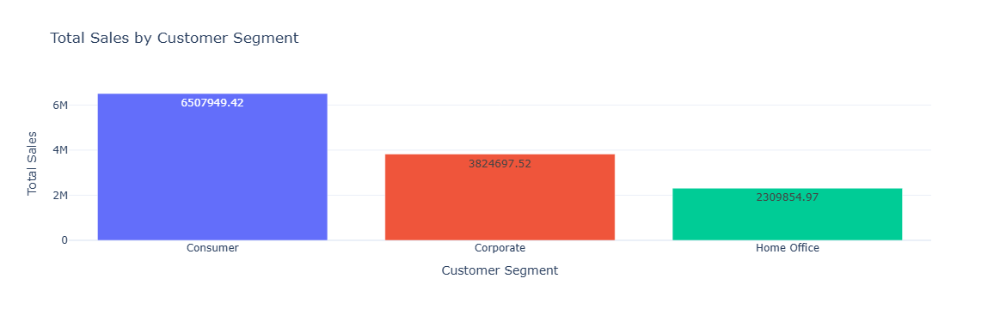

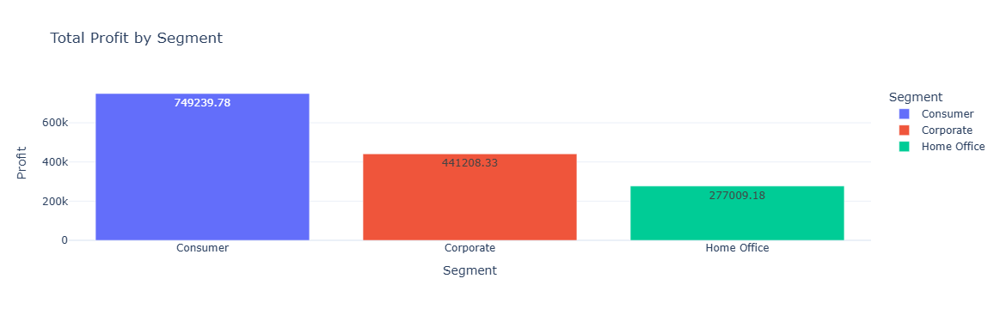

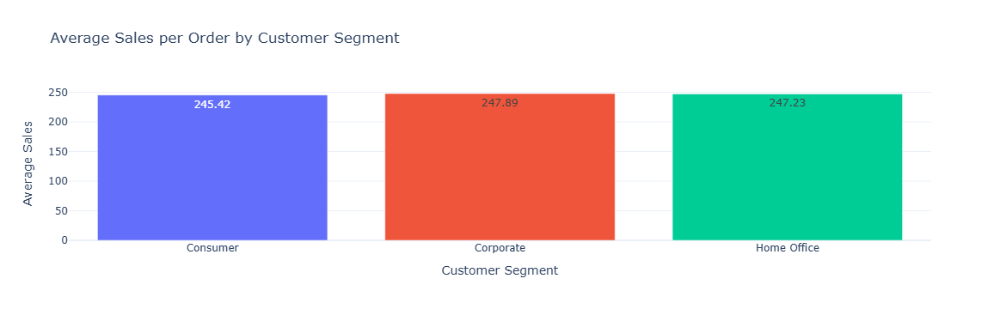

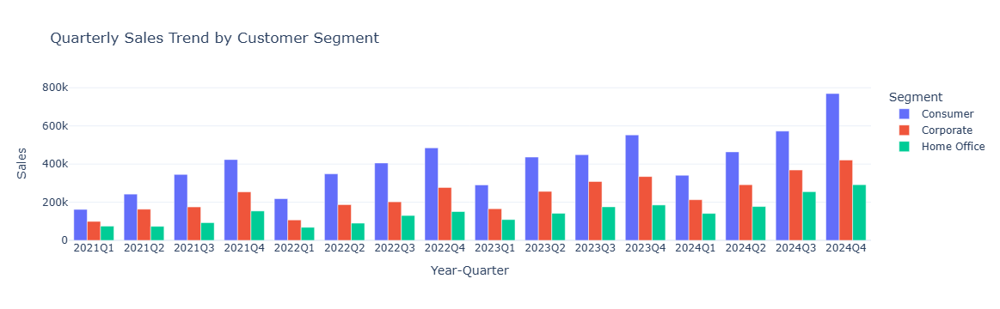

In [20]:
# 1. Total Sales by Customer Segment
segment_sales = superstore.groupby('Segment')['Sales'].sum().reset_index()
segment_sales = segment_sales.sort_values(by="Sales", ascending=False)
colors = qualitative.Plotly[:len(segment_sales)]
fig_segmentsales = go.Figure()
fig_segmentsales.add_trace(go.Bar(x=segment_sales['Segment'], y=segment_sales['Sales'], marker_color=colors, text=segment_sales['Sales'].round(2), textposition="auto"))
fig_segmentsales.update_layout(title="Total Sales by Customer Segment", xaxis_title="Customer Segment", yaxis_title="Total Sales")

# 2. Total Profit by Customer Segment
segment_profit = superstore.groupby('Segment')['Profit'].sum().reset_index()
segment_profit = segment_profit.sort_values(by="Profit", ascending=False)
fig_segmentprofit = px.bar(segment_profit, x='Segment', y='Profit', color='Segment', color_discrete_sequence=colors, text=segment_profit["Profit"].round(2), title="Total Profit by Segment")
fig_segmentprofit.update_layout(xaxis_title='Segment', yaxis_title='Profit')

# 3. Average Sales per Order per Segment
avg_sales_per_order = superstore.groupby('Segment')['Sales'].mean().reset_index()
avcolor = qualitative.Plotly[:len(avg_sales_per_order)]
fig_avgsegmentsales = go.Figure()
fig_avgsegmentsales.add_trace(go.Bar(x=avg_sales_per_order['Segment'], y=avg_sales_per_order['Sales'],marker_color=avcolor, text=avg_sales_per_order['Sales'].round(2), textposition="auto"))
fig_avgsegmentsales.update_layout(title="Average Sales per Order by Customer Segment", xaxis_title=" Customer Segment",yaxis_title="Average Sales")

# 4. Sales Trend Over Time by Segment
segment_yearquarter_sales = superstore.groupby(['Year-Quarter', 'Segment'])['Sales'].sum().reset_index()
segments = segment_yearquarter_sales['Segment'].unique()
yearquarter = sorted(segment_yearquarter_sales["Year-Quarter"].unique())
fig_segmentyearquarter = go.Figure()
for i, segment in enumerate(segments):
    data = segment_yearquarter_sales[segment_yearquarter_sales['Segment'] == segment]
    fig_segmentyearquarter.add_trace(go.Bar(x=data['Year-Quarter'], y=data['Sales'], name=segment, marker_color=colors[i % len(colors)]))
fig_segmentyearquarter.update_layout(barmode="group",title='Quarterly Sales Trend by Customer Segment', xaxis_title='Year-Quarter', yaxis_title='Sales', legend_title='Segment')

# Show the figures
fig_segmentsales.show()
fig_segmentprofit.show()
fig_avgsegmentsales.show()
fig_segmentyearquarter.show()

### Question 4: Which cities or states are the top contributors to total sales and profit, and which ones are underperforming?

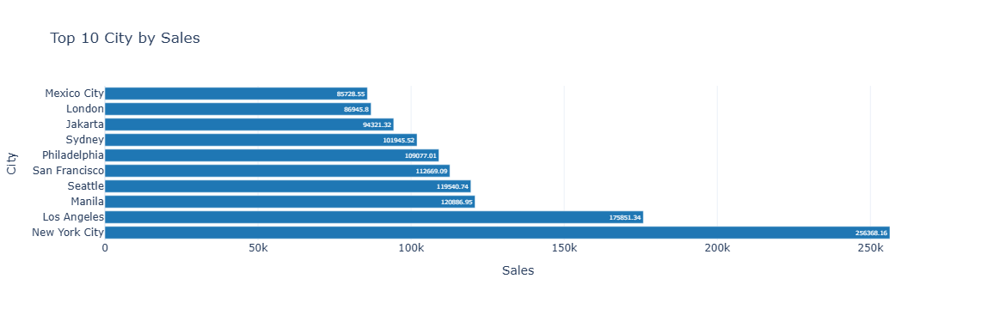

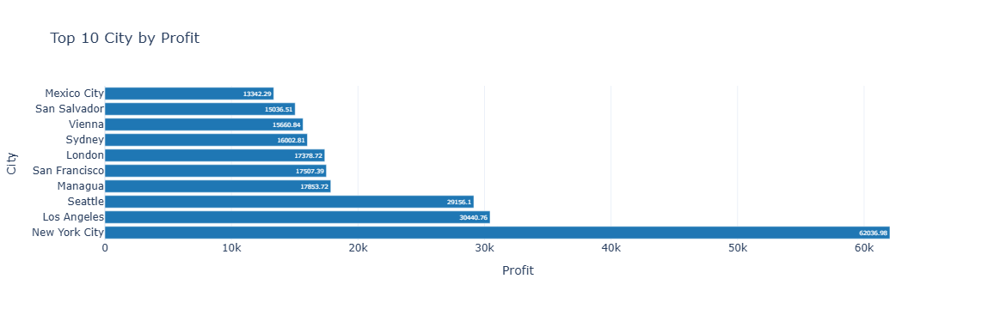

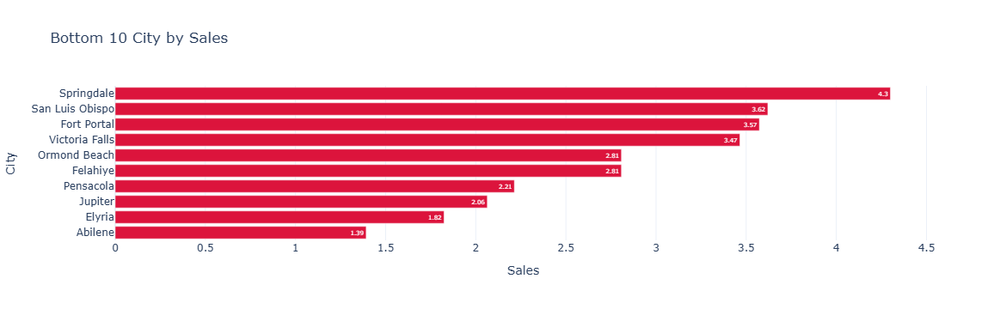

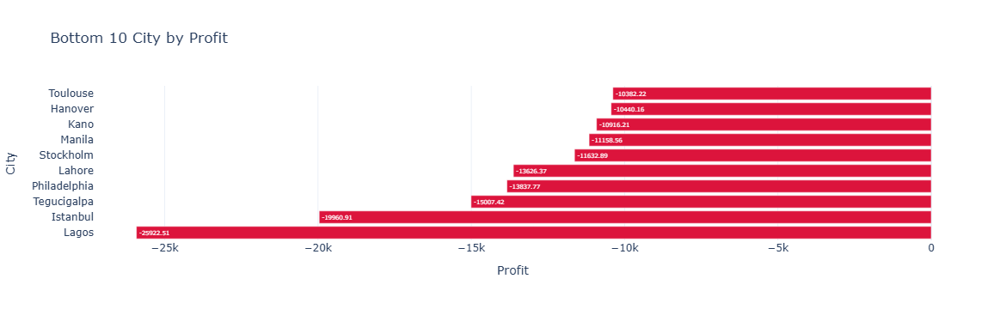

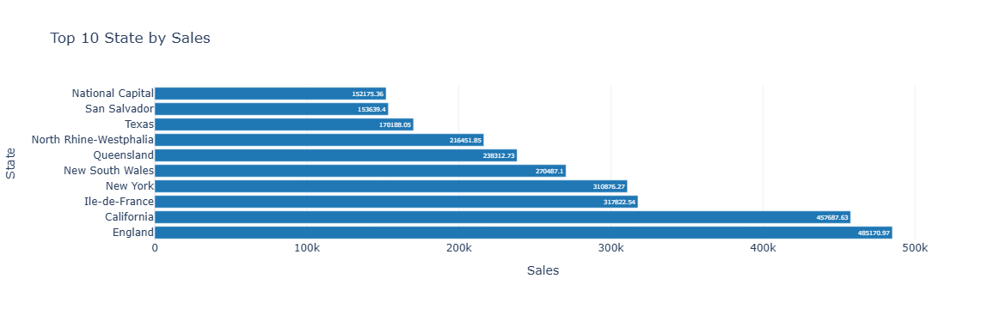

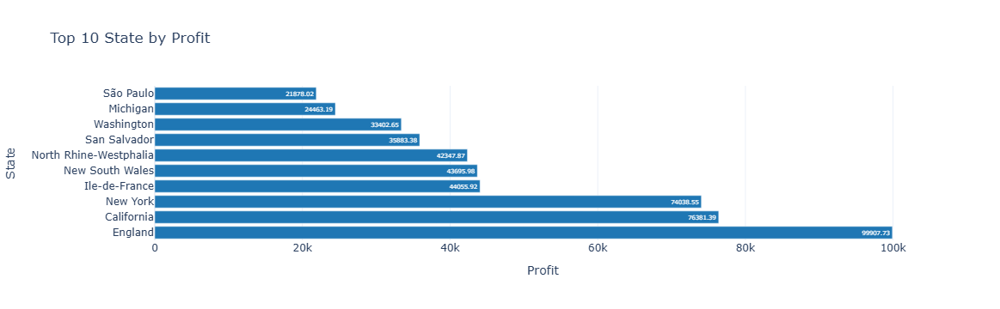

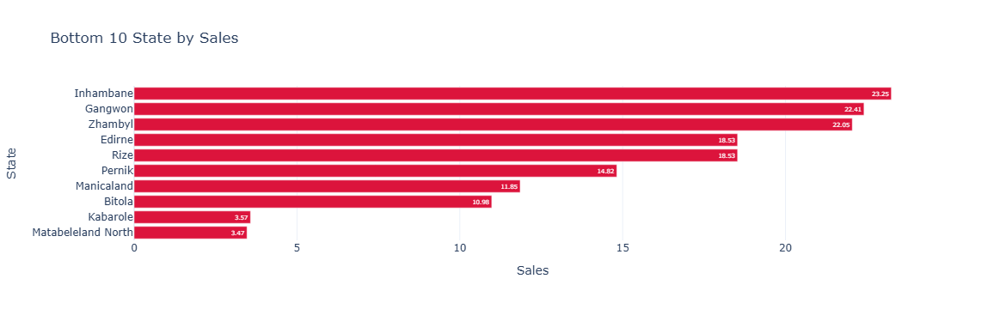

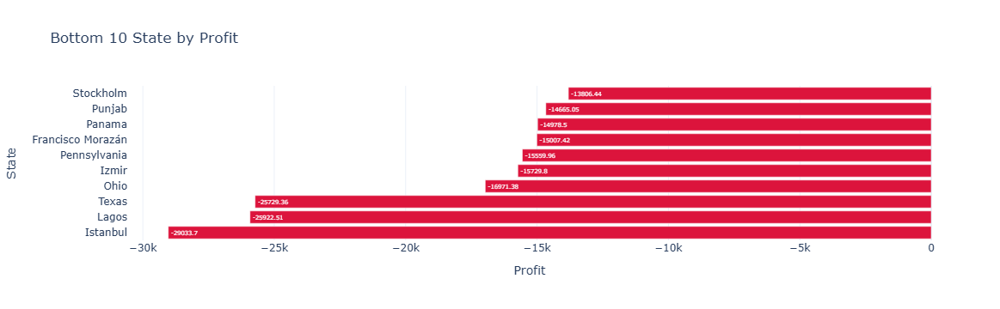

In [21]:
# 1. Top & Bottom (Loss-making) Cities by Sales and Profit
city_summary = superstore.groupby('City')[['Sales', 'Profit']].sum().reset_index()
top_city_sales = city_summary.sort_values(by='Sales', ascending=False).head(10)
top_city_profit = city_summary.sort_values(by='Profit', ascending=False).head(10)
bottom_city_sales = city_summary.sort_values(by='Sales').head(10)
bottom_city_profit = city_summary.sort_values(by='Profit').head(10)

# 1.1. Top 10 Cities by Sales
fig_topcity_sales = go.Figure(go.Bar(x=top_city_sales["Sales"], y=top_city_sales["City"], orientation="h", marker_color="#1f77b4", text=top_city_sales["Sales"].round(2), textposition='auto', name="Sales"))
fig_topcity_sales.update_layout(title="Top 10 City by Sales", xaxis_title="Sales", yaxis_title="City")

# 1.2. Top 10 Cities by Profit
fig_topcity_profit = go.Figure(go.Bar(x=top_city_profit["Profit"], y=top_city_profit["City"], orientation="h", marker_color="#1f77b4", text=top_city_profit["Profit"].round(2), textposition='auto', name="Profit"))
fig_topcity_profit.update_layout(title="Top 10 City by Profit", xaxis_title="Profit", yaxis_title="City")

# 1.3. Bottom 10 Cities by Sales
fig_bottomcity_sales = go.Figure(go.Bar(x=bottom_city_sales["Sales"], y=bottom_city_sales["City"], orientation="h", marker_color="crimson", text=bottom_city_sales["Sales"].round(2), textposition='auto', name="Sales"))
fig_bottomcity_sales.update_layout(title="Bottom 10 City by Sales", xaxis_title="Sales", yaxis_title="City")

# 1.4. Bottom 10 Cities by Profit
fig_bottomcity_profit = go.Figure(go.Bar(x=bottom_city_profit["Profit"], y=bottom_city_profit["City"], orientation="h", marker_color="crimson", text=bottom_city_profit["Profit"].round(2), textposition='auto', name="Profit"))
fig_bottomcity_profit.update_layout(title="Bottom 10 City by Profit", xaxis_title="Profit", yaxis_title="City")

city_profit = superstore.groupby('City')['Profit'].sum().reset_index()
bottom_cities_profit = city_profit.sort_values(by='Profit').head(10)


# 2. Top & Bottom (Loss-making) States by Sales and Profit
states_summary = superstore.groupby('State')[['Sales', 'Profit']].sum().reset_index()
top_states_sales = states_summary.sort_values(by='Sales', ascending=False).head(10)
top_states_profit = states_summary.sort_values(by='Profit', ascending=False).head(10)
bottom_states_sales = states_summary.sort_values(by='Sales').head(10)
bottom_states_profit = states_summary.sort_values(by='Profit').head(10)

# 1.1. Top 10 State by Sales
fig_topstates_sales = go.Figure(go.Bar(x=top_states_sales["Sales"], y=top_states_sales["State"], orientation="h", marker_color="#1f77b4", text=top_states_sales["Sales"].round(2), textposition='auto', name="Sales"))
fig_topstates_sales.update_layout(title="Top 10 State by Sales", xaxis_title="Sales", yaxis_title="State")

# 1.2. Top 10 State by Profit
fig_topstates_profit = go.Figure(go.Bar(x=top_states_profit["Profit"], y=top_states_profit["State"], orientation="h", marker_color="#1f77b4", text=top_states_profit["Profit"].round(2), textposition='auto', name="Profit"))
fig_topstates_profit.update_layout(title="Top 10 State by Profit", xaxis_title="Profit", yaxis_title="State")

# 1.3. Bottom 10 State by Sales
fig_bottomstates_sales = go.Figure(go.Bar(x=bottom_states_sales["Sales"], y=bottom_states_sales["State"], orientation="h", marker_color="crimson", text=bottom_states_sales["Sales"].round(2), textposition='auto', name="Sales"))
fig_bottomstates_sales.update_layout(title="Bottom 10 State by Sales", xaxis_title="Sales", yaxis_title="State")

# 1.4. Bottom 10 State by Profit
fig_bottomstates_profit = go.Figure(go.Bar(x=bottom_states_profit["Profit"], y=bottom_states_profit["State"], orientation="h", marker_color="crimson", text=bottom_states_profit["Profit"].round(2), textposition='auto', name="Profit"))
fig_bottomstates_profit.update_layout(title="Bottom 10 State by Profit", xaxis_title="Profit", yaxis_title="State")


# Show all the figures
fig_topcity_sales.show()
fig_topcity_profit.show()
fig_bottomcity_sales.show()
fig_bottomcity_profit.show()
fig_topstates_sales.show()
fig_topstates_profit.show()
fig_bottomstates_sales.show()
fig_bottomstates_profit.show()

### Question 5: What is the correlation between discount rates and profit margins? or Do discounts help or hurt profit?

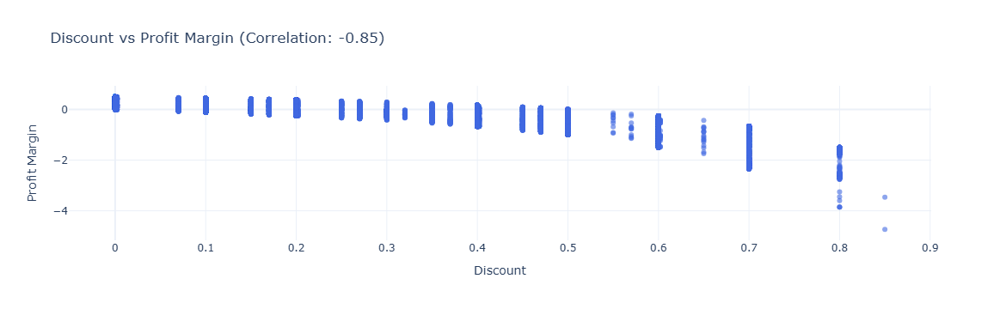

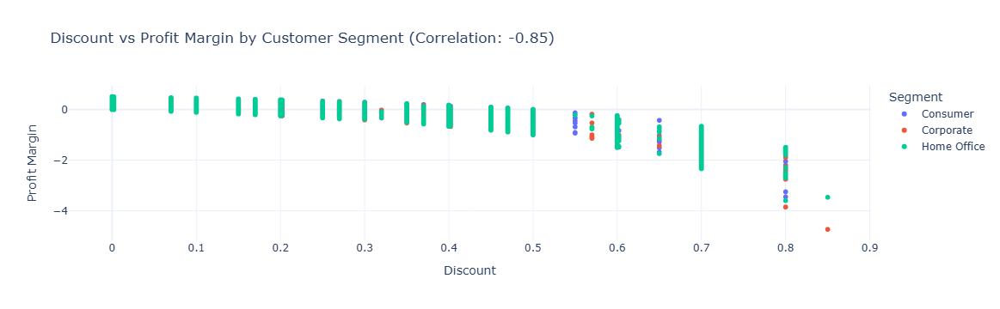

In [22]:
# Importing Pearson correlation function from SciPy to measure the linear relationship between discount and profit margin
from scipy.stats import pearsonr
# Creating a new column 'Profit Margin' by dividing Profit by Sales
superstore['Profit Margin'] = superstore['Profit'] / superstore['Sales']
# Calculating the Pearson correlation coefficient between Discount and Profit Margin
corr, _ = pearsonr(superstore['Discount'], superstore['Profit Margin'])
# # Creating a scatter plot to visualize the relationship between Discount and Profit Margin
fig_corrdiscountprofit = go.Figure()
fig_corrdiscountprofit.add_trace(go.Scatter(x=superstore['Discount'], y=superstore['Profit Margin'], mode='markers', marker=dict(color='royalblue',size=6,opacity=0.6), text=superstore['Sub-Category'], name='Discount vs Profit Margin'))
fig_corrdiscountprofit.update_layout(title=f'Discount vs Profit Margin (Correlation: {corr:.2f})', xaxis_title='Discount', yaxis_title='Profit Margin')

# Creating a second scatter plot segmented by Customer Segment to provide deeper insights
fig_corrdiscountprofit_seg = px.scatter(superstore, x='Discount', y='Profit Margin', color='Segment', title=f'Discount vs Profit Margin by Customer Segment (Correlation: {corr:.2f})', hover_data=['Sub-Category', 'Category'])

# Displaying both visualizations
fig_corrdiscountprofit.show()
fig_corrdiscountprofit_seg.show()

### Question 6: Which product categories and sub-categories are most (or least) profitable?

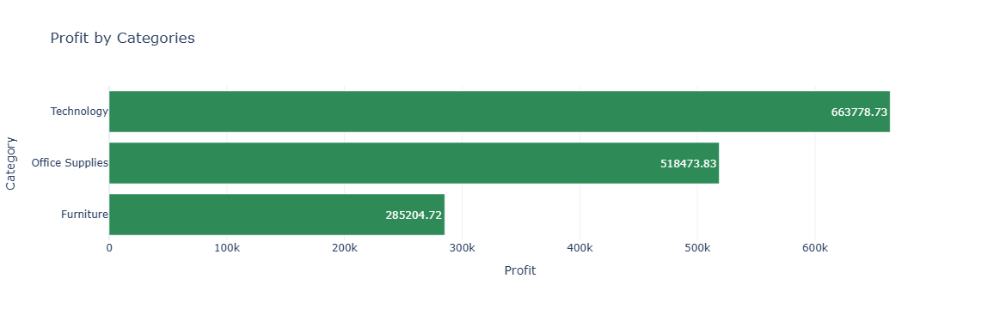

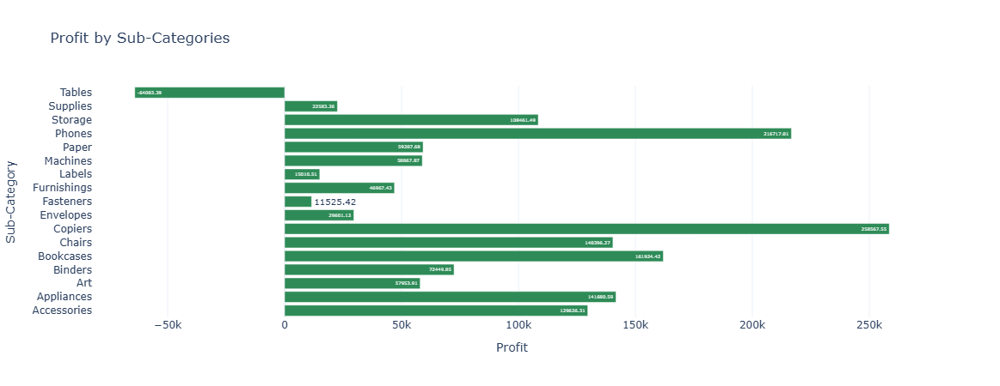

In [23]:
# 1: Proft by Category
category_profit = superstore.groupby('Category')['Profit'].sum().reset_index()
fig_categoryprofit = go.Figure(go.Bar(x=category_profit['Profit'], y=category_profit['Category'], orientation='h', marker_color='seagreen', text=category_profit['Profit'].round(2), textposition='auto', name='Most Profitable'))
fig_categoryprofit.update_layout(title='Profit by Categories', xaxis_title='Profit',yaxis_title='Category')

# 2: Proft by Sub-Category
subcategory_profit = superstore.groupby('Sub-Category')['Profit'].sum().reset_index()
fig_subcategoryprofit = go.Figure(go.Bar(x=subcategory_profit['Profit'], y=subcategory_profit['Sub-Category'], orientation='h', marker_color='seagreen', text=subcategory_profit['Profit'].round(2), textposition='auto', name='Most Profitable'))
fig_subcategoryprofit.update_layout(height=450,title='Profit by Sub-Categories', xaxis_title='Profit',yaxis_title='Sub-Category')

# Displaying visualizations
fig_categoryprofit.show()
fig_subcategoryprofit.show()

### Question 7: What is the impact of shipping cost on overall profitability? Are there shipping modes or regions that consistently incur high costs?

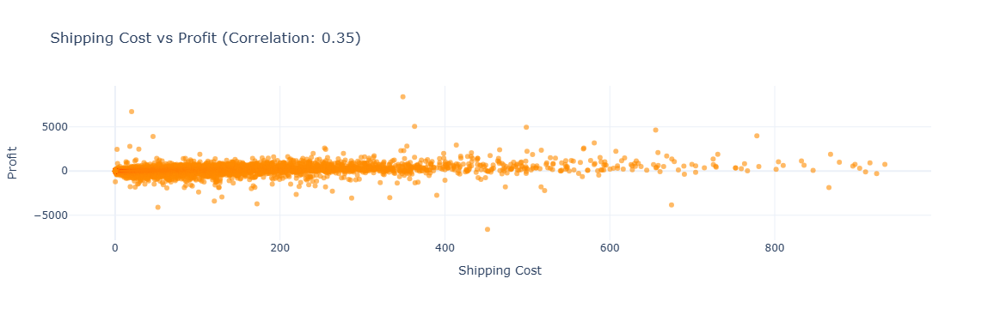

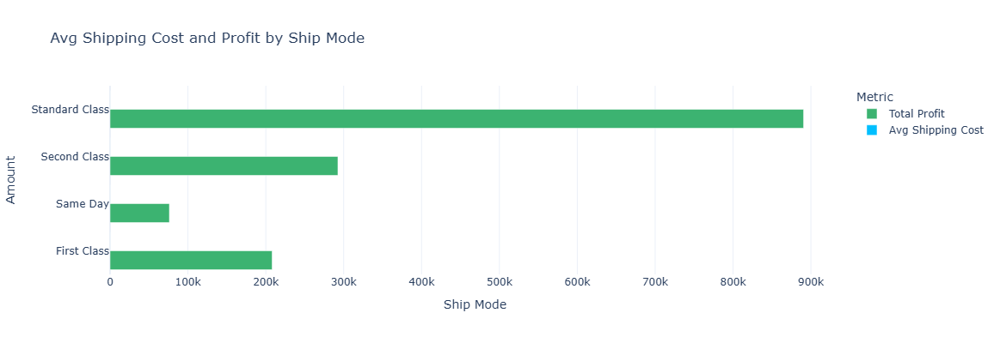

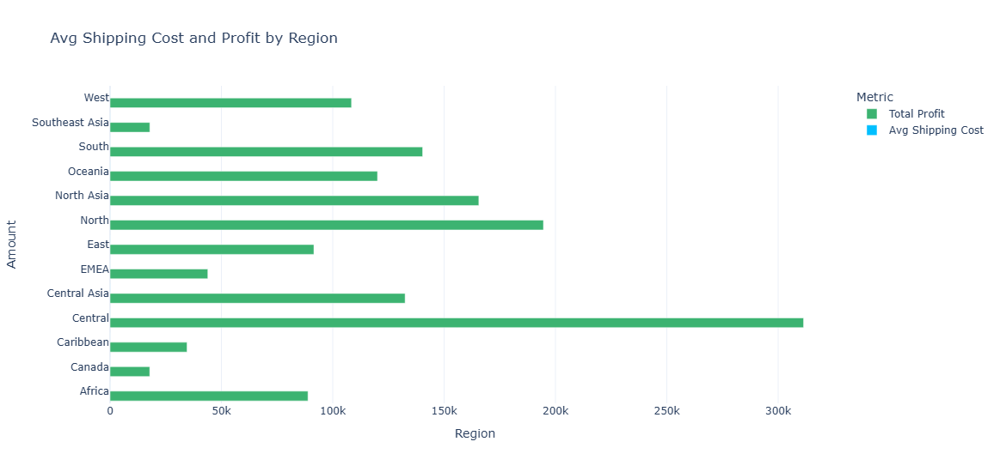

In [24]:
# 1. Shipping cost vs profit
corr, _ = pearsonr(superstore['Shipping Cost'], superstore['Profit'])
fig_shipcost = go.Figure()
fig_shipcost.add_trace(go.Scatter(x=superstore['Shipping Cost'], y=superstore['Profit'], mode='markers', marker=dict(color='darkorange', opacity=0.6, size=6), text=superstore['Sub-Category'], name='Shipping Cost vs Profit'))
fig_shipcost.update_layout(title=f'Shipping Cost vs Profit (Correlation: {corr:.2f})', xaxis_title='Shipping Cost', yaxis_title='Profit')

# 2. Average shipping cost & Profit by ship mode
# Group by Ship Mode
shipmode_summary = superstore.groupby('Ship Mode').agg({'Shipping Cost': 'mean','Profit': 'sum'}).reset_index()
# Dual Bar Chart - Avg Shipping Cost & Total Profit
fig_shipprofit = go.Figure()
fig_shipprofit.add_trace(go.Bar(x=shipmode_summary['Profit'], y=shipmode_summary['Ship Mode'], orientation="h", name='Total Profit', marker_color='mediumseagreen'))
fig_shipprofit.add_trace(go.Bar(x=shipmode_summary['Shipping Cost'], y=shipmode_summary['Ship Mode'], orientation="h", name='Avg Shipping Cost',marker_color='deepskyblue'))
fig_shipprofit.update_layout(height=400,barmode='group', title='Avg Shipping Cost and Profit by Ship Mode', xaxis_title='Ship Mode', yaxis_title='Amount', legend_title='Metric')

# 3. Average shipping cost & Profit by Region
# Group by Region
region_summary = superstore.groupby('Region').agg({'Shipping Cost': 'mean','Profit': 'sum'}).reset_index()
# Dual Bar Chart - Avg Shipping Cost & Total Profit
fig_regionprofit = go.Figure()
fig_regionprofit.add_trace(go.Bar(x=region_summary['Profit'], y=region_summary['Region'], orientation="h", name='Total Profit', marker_color='mediumseagreen'))
fig_regionprofit.add_trace(go.Bar(x=region_summary['Shipping Cost'], y=region_summary['Region'], orientation="h", name='Avg Shipping Cost',marker_color='deepskyblue'))
fig_regionprofit.update_layout(height=550,barmode='group', title='Avg Shipping Cost and Profit by Region', xaxis_title='Region', yaxis_title='Amount', legend_title='Metric')

# Displaying visuals
fig_shipcost.show()
fig_shipprofit.show()
fig_regionprofit.show()

### Question 8: What is the average Lead time (Ship Date - Order Date), and how does it vary by region, market, or ship mode?

In [25]:
# Calculate lead time in days
superstore['Lead Time (Days)'] = (superstore['Ship Date'] - superstore['Order Date']).dt.days

# Distribution of Average Lead Time
avg_lead_time = superstore['Lead Time (Days)'].mean()
avg_lead_time

4.484519399493078

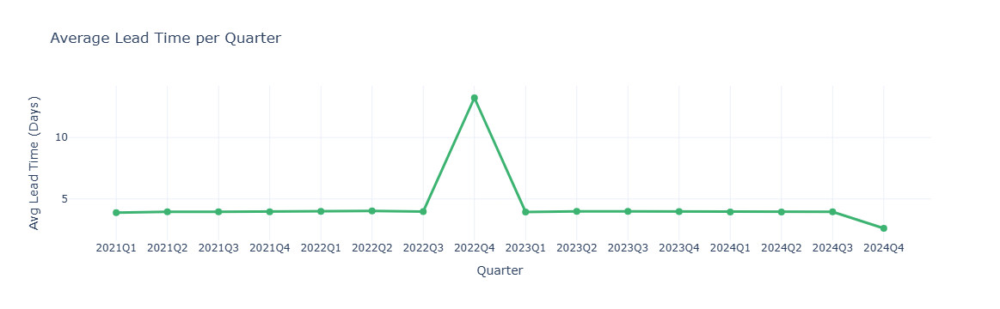

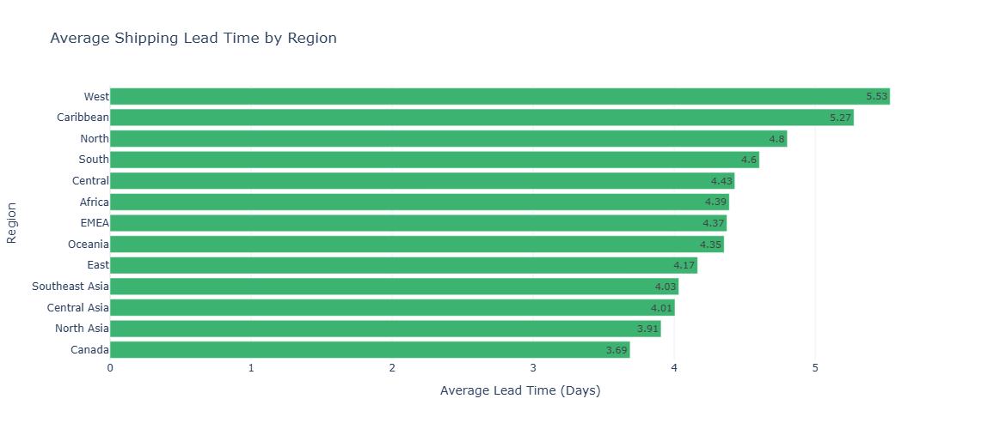

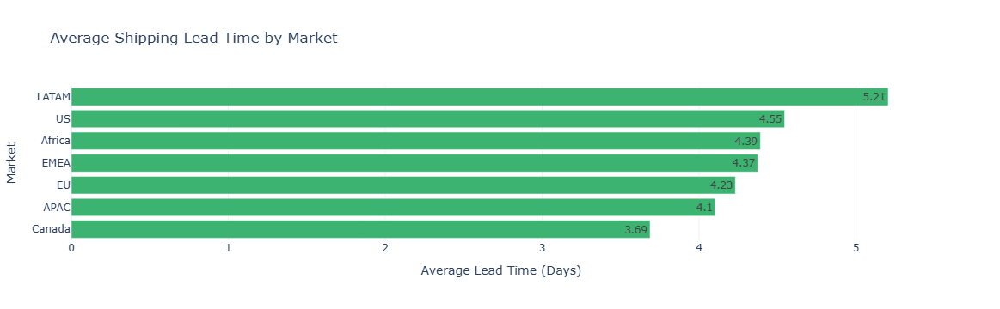

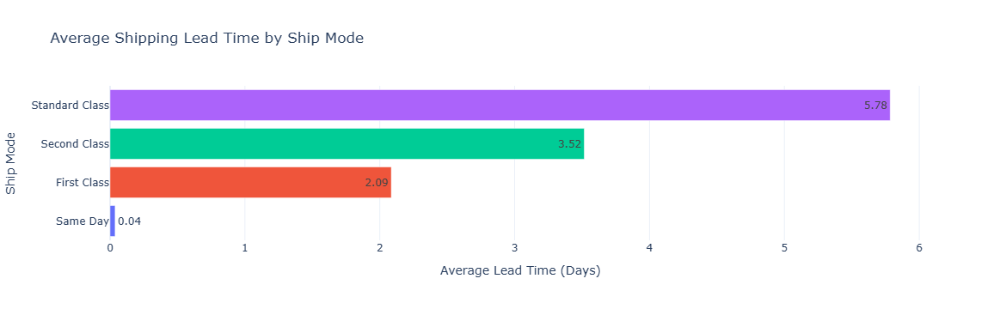

In [26]:
# Average Lead Time per Quarter
quarterly_avg = superstore.groupby('Year-Quarter')['Lead Time (Days)'].mean().reset_index()
fig_leadquarter = px.line(quarterly_avg, x='Year-Quarter', y='Lead Time (Days)', markers=True,title='Average Lead Time per Quarter')
fig_leadquarter.update_traces(line=dict(color='mediumseagreen', width=3), marker=dict(size=8))
fig_leadquarter.update_layout(xaxis_title='Quarter', yaxis_title='Avg Lead Time (Days)')

# Average Lead Time by Region
region_lead = superstore.groupby('Region')['Lead Time (Days)'].mean().reset_index().sort_values(by='Lead Time (Days)')
fig_regionlead = go.Figure(go.Bar(x=region_lead['Lead Time (Days)'], y=region_lead['Region'], orientation='h', marker_color='mediumseagreen', text=region_lead['Lead Time (Days)'].round(2), textposition='auto'))
fig_regionlead.update_layout(height=500,title='Average Shipping Lead Time by Region', xaxis_title='Average Lead Time (Days)', yaxis_title='Region')

# Average Lead Time by Market
market_lead = superstore.groupby('Market')['Lead Time (Days)'].mean().reset_index().sort_values(by='Lead Time (Days)')
fig_marketlead = go.Figure(go.Bar(x=market_lead['Lead Time (Days)'], y=market_lead['Market'], orientation='h', marker_color='mediumseagreen', text=market_lead['Lead Time (Days)'].round(2), textposition='auto'))
fig_marketlead.update_layout(title='Average Shipping Lead Time by Market', xaxis_title='Average Lead Time (Days)', yaxis_title='Market')

# Average Lead Time by Ship Mode
shipmode_lead = superstore.groupby('Ship Mode')['Lead Time (Days)'].mean().reset_index().sort_values(by='Lead Time (Days)')
fig_shiplead = go.Figure(go.Bar(x=shipmode_lead['Lead Time (Days)'], y=shipmode_lead['Ship Mode'], orientation='h', marker_color=qualitative.Plotly, text=shipmode_lead['Lead Time (Days)'].round(2), textposition='auto'))
fig_shiplead.update_layout(title='Average Shipping Lead Time by Ship Mode', xaxis_title='Average Lead Time (Days)', yaxis_title='Ship Mode')

# Displaying visuals
fig_leadquarter.show()
fig_regionlead.show()
fig_marketlead.show()
fig_shiplead.show()

### Question 9: Who are the top 10 customers by sales and profit? What purchasing behaviors do they exhibit?

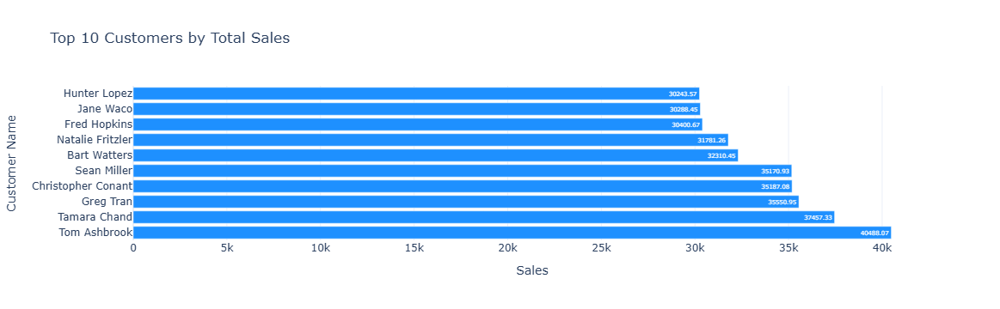

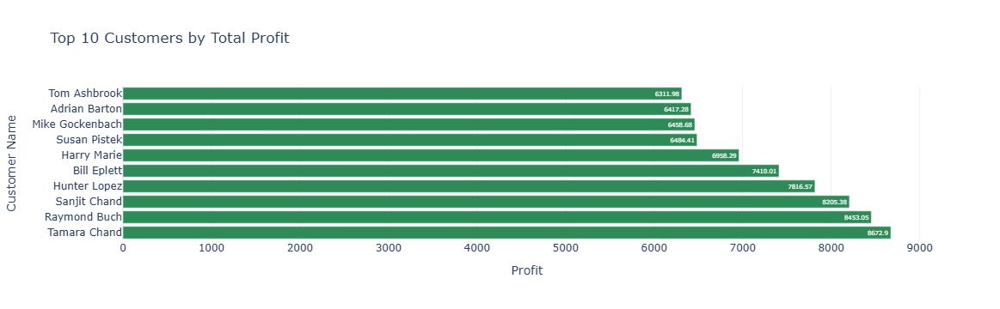

,Customer Name,Sales,Profit,Avg Discount,Order Count
758,Tom Ashbrook,40488.07080,6311.97910,0.090125,30
731,Tamara Chand,37457.33300,8672.89890,0.184682,36
313,Greg Tran,35550.95428,5214.13118,0.141448,34
157,Christopher Conant,35187.07640,5603.33370,0.129041,39
687,Sean Miller,35170.93296,-409.70634,0.190240,28
73,Bart Watters,32310.44650,3595.88590,0.096667,45
558,Natalie Fritzler,31781.25850,1542.82110,0.179474,43
290,Fred Hopkins,30400.67452,4609.29112,0.141366,39
347,Jane Waco,30288.45030,6265.84570,0.114933,40
335,Hunter Lopez,30243.56658,7816.56778,0.117774,24


In [27]:
# Group by Customer Name
customer_summary = superstore.groupby('Customer Name').agg({'Sales': 'sum','Profit': 'sum','Discount': 'mean','Order ID': 'nunique'}).reset_index()
# Rename for clarity
customer_summary.rename(columns={'Order ID': 'Order Count', 'Discount': 'Avg Discount'}, inplace=True)

# Top 10 customers by Sales
top_customers_sales = customer_summary.sort_values(by='Sales', ascending=False).head(10)
fig_customersales = go.Figure(go.Bar(x=top_customers_sales['Sales'], y=top_customers_sales['Customer Name'], orientation='h', marker_color='dodgerblue', text=top_customers_sales['Sales'].round(2), textposition='auto'))
fig_customersales.update_layout(title='Top 10 Customers by Total Sales', xaxis_title='Sales', yaxis_title='Customer Name')

# Top 10 customers by Profit
top_customers_profit = customer_summary.sort_values(by='Profit', ascending=False).head(10)
fig_customerprofit = go.Figure(go.Bar(x=top_customers_profit['Profit'], y=top_customers_profit['Customer Name'], orientation='h', marker_color='seagreen', text=top_customers_profit['Profit'].round(2), textposition='auto'))
fig_customerprofit.update_layout(title='Top 10 Customers by Total Profit', xaxis_title='Profit', yaxis_title='Customer Name', template='plotly_white')

# show visuals
fig_customersales.show()
fig_customerprofit.show()

# Customer Behavioral Summary Table
# Combine both top lists (union)
top_customers = pd.concat([top_customers_sales, top_customers_profit]).drop_duplicates()
# Display or export for deeper inspection
top_customers.sort_values(by='Sales', ascending=False)

### Question 10: Which products have the highest sales volume but low profit margins? or Which products sell well but make little profit?

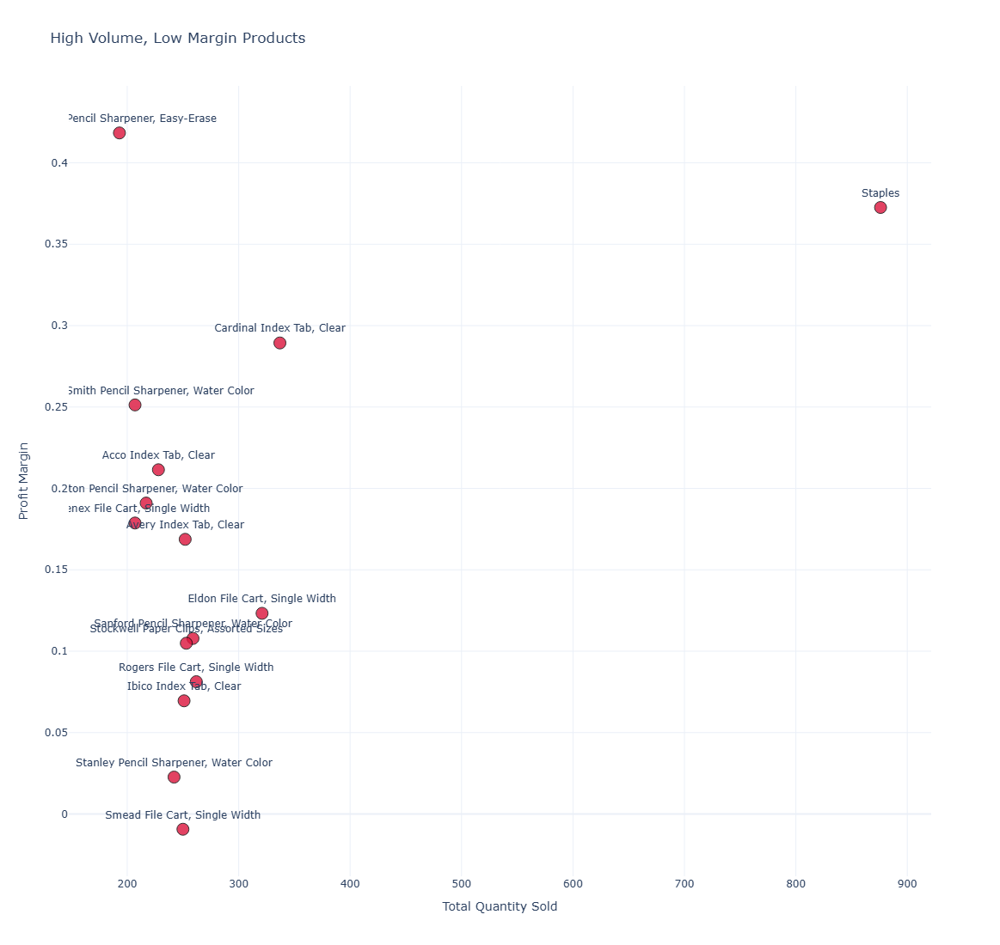

In [28]:
# Group by Product Name
product_summary = superstore.groupby('Product Name').agg({'Quantity': 'sum','Sales': 'sum','Profit': 'sum'}).reset_index()
# Calculate Profit Margin
product_summary['Profit Margin'] = product_summary['Profit'] / product_summary['Sales']
# Sort to find high-volume, low-margin products
low_margin_products = product_summary.sort_values(by=['Quantity', 'Profit Margin'], ascending=[False, True])
# Pick top 15 high-quantity, low-margin products
top_low_margin = low_margin_products.head(15)

# Quantity vs Profit Margin (Highlighting Problematic Products Sub-Categories)
fig_lowmargin = go.Figure()
fig_lowmargin.add_trace(go.Scatter(x=top_low_margin['Quantity'], y=top_low_margin['Profit Margin'], mode='markers+text', text=top_low_margin['Product Name'], textposition='top center', customdata=superstore[['Product Name', 'Sub-Category']], marker=dict(size=14,color='crimson',opacity=0.8,line=dict(width=1, color='black')), hovertemplate='Quantity: %{x}<br>' + 'Profit Margin: %{y:.2%}<br>' + 'Product: %{customdata[0]}<br>' + 'Sub-Category: %{customdata[1]}<extra></extra>', name='Products',))
fig_lowmargin.update_layout(height=1100,title='High Volume, Low Margin Products', xaxis_title='Total Quantity Sold', yaxis_title='Profit Margin', showlegend=False)

# Show visual
fig_lowmargin.show()

## Summary of Insights and Strategic Recommendations: -

### Key Insights
#### Sales Performance Over Time
- Sales increased steadily from 2022 to 2024, with Q4 2024 recording the highest sales.
- Q1 2022 was the weakest quarter in terms of revenue.
- The Central region consistently generated the highest quarterly sales; Canada had the lowest.
#### Product Category and Sub-Category Sales
- Technology is the top-selling category with 4.7 million USD in revenue.
- The Phones sub-category led with 1.7 million USD, followed by Copiers and Chairs (around 1.5 million USD each).
- Labels generated the least revenue at 73,000 USD.
#### Customer Segment Performance
- The Consumer segment contributed the most to both sales (6.5 million USD) and profit (749,000 USD).
- The Home Office segment showed the weakest performance with 2.3 million USD in sales and 277,000 USD in profit.
#### Geographic Sales and Profit Trends
- Top sales cities: New York City (256,000 USD), Los Angeles, Manila.
- Top profit cities: New York City (62,000 USD), Los Angeles, Seattle.
- Bottom profit cities: Lagos (-26,000 USD), Istanbul (-20,000 USD), Tegucigalpa (-15,000 USD).
- Top states by sales: England, California, Île-de-France.
- Bottom profit states: Istanbul, Lagos, Texas.
#### Impact of Discounting on Profitability
- Strong negative correlation (-0.85) between discount rate and profit margin.
- High discounts significantly reduce profit and should be applied more strategically
#### Product Profitability
- Technology products yielded the most profit (664,000 USD); Furniture was least profitable (285,000 USD).
- Copiers and Phones were top profit-driving sub-categories.
- Tables incurred a loss (-64,000 USD); Fasteners had the lowest positive profit (11,000 USD).
### Shipping Cost vs. Profit
- Mild positive correlation (0.35) between shipping cost and profit.
- Standard Class shipping mode brought in the highest profit (890,000 USD).
- Same Day shipping mode had the highest average cost (43 USD) and the lowest profit (76,000 USD).
- Central region is the most profitable in terms of average shipping cost.
#### Shipping Lead Times
- Average shipping lead time: 4.48 days.
- Longest lead time in the West region (5.5 days); shortest in Canada (3.7 days).
- Standard Class has the longest average lead time (5.78 days); Same Day the shortest (0.04 days).
#### Top Customers and Their Behavior
- Top sales customers: Tom Ashbrook (40,000 USD), Tamara Chand, Greg Tran.
- Top profit customers: Tamara Chand (8,600 USD), Raymond Buch, Sanjit Chand.
- These customers purchase frequently, focus on high-value products, avoid deep discounts, and prefer cost-efficient shipping.
#### Low-Margin Products
- Most low-margin products are in the Phones category (4 products).
- Chairs and Tables follow with 3 low-margin products each.
- These areas may require pricing review and margin optimization.

### Business Recommendations

#### 1. Optimize Discount Strategy
- Avoid applying high discounts across the board, as there is a strong negative correlation between discount rate and profit margin.
- Implement targeted discounting strategies, such as for specific customer segments or during slow periods, to maintain profitability.
#### 2. Focus on High-Performing Segments and Customers
- Prioritize marketing and retention efforts toward the Consumer segment, which contributes the most to overall sales and profit.
- Identify top customers (e.g., Tamara Chand, Tom Ashbrook) and provide loyalty incentives or exclusive offers to maintain long-term value.
#### 3. Review Low-Margin and Loss-Making Products
- Reevaluate pricing, cost structure, or marketing strategy for products like Tables, Fasteners, and low-margin items in the Phones and Chairs categories.
- Consider bundling, cost reduction, or discontinuation for products with consistently negative or low margins.
#### 4. Improve Shipping Efficiency
- Promote the use of Standard Class shipping, which is the most cost-effective and profitable.
- Investigate why Same Day shipping leads to high costs and lower profit — it may be worth limiting or optimizing this shipping option.
#### 5. Address Underperforming Regions and Markets
- Review business operations and customer needs in underperforming regions such as Canada, Lagos, and Istanbul.
- Consider localized promotions, improved logistics, or even exiting markets where losses are unsustainable.
#### 6. Optimize Lead Time and Logistics
- Explore ways to reduce lead time in regions with long shipping durations, particularly the West region and LATAM market.
- Faster delivery options can be selectively offered in high-performing regions to improve customer satisfaction without sacrificing profit.
#### 7. Expand Sales in High-Potential Categories
- Invest more in the Technology category and high-margin sub-categories like Copiers and Phones.
- Analyze top-selling products for patterns in features, pricing, or customer preferences that can guide future product strategy.

### Conclusion

This analysis provided valuable insights into the sales, profit, customer behavior, and operational performance of the business based on a dataset of over 51,000 records. <br>
Key findings include strong sales growth over time, especially in the Central region and Consumer segment. The Technology category, particularly Phones and Copiers, is the top performer in both sales and profit. However, several products and regions are underperforming — such as Tables with negative profit and regions like Canada and Lagos with low or negative returns. Operationally, high shipping costs and long lead times in certain regions affect profitability. Standard Class shipping is the most cost-effective option, while Same Day shipping tends to be expensive and less profitable. Discounts also have a significant negative impact on profit margins, suggesting the need for a more strategic approach. By focusing on high-performing products, customers, and regions — while improving cost efficiency and discount strategies — the business can significantly increase overall profitability and long-term growth. <br>
This analysis serves as a foundation for data-driven decision-making across departments such as sales, marketing, product management, and operations.